# Facial segmentation with mobile-Unet

The objective of this notebook is to create a neural network for facial segmentation task.

First let's install and import the necessary package. Also, let's install mediapipe to make the process of the dataset.

In [ ]:
!pip install scipy

In [ ]:
!pip install livelossplot

## 1. Imports

In [ ]:
import json
import os
import fnmatch
from tqdm import tqdm
import cv2
import pandas as pd
import math
import numpy as np
from PIL import Image
import tensorflow as tf
from tensorflow import keras
from tensorflow.keras.callbacks import ModelCheckpoint
from tensorflow.keras import backend
from tensorflow.keras.callbacks import CSVLogger
from livelossplot import PlotLossesKeras
import matplotlib.pyplot as plt
from keras.models import Sequential
from copy import deepcopy

from scipy.spatial import ConvexHull, convex_hull_plot_2d

#import tensorflow_addons as tfa
from keras import backend
import albumentations as A
from scipy.spatial import ConvexHull

from tensorflow.keras.layers import Conv2D, BatchNormalization, Activation, MaxPool2D, Conv2D, Conv2DTranspose, Concatenate
from tensorflow.keras.models import Model
from tensorflow.keras.applications import MobileNetV2, MobileNetV3Large

from copy import deepcopy

## 2. Dataset investigation

In [ ]:
path_images = '/kaggle/input/human-faces/Humans'
files_name = [f for f in os.listdir(path_images) if os.path.isfile(os.path.join(path_images, f))]

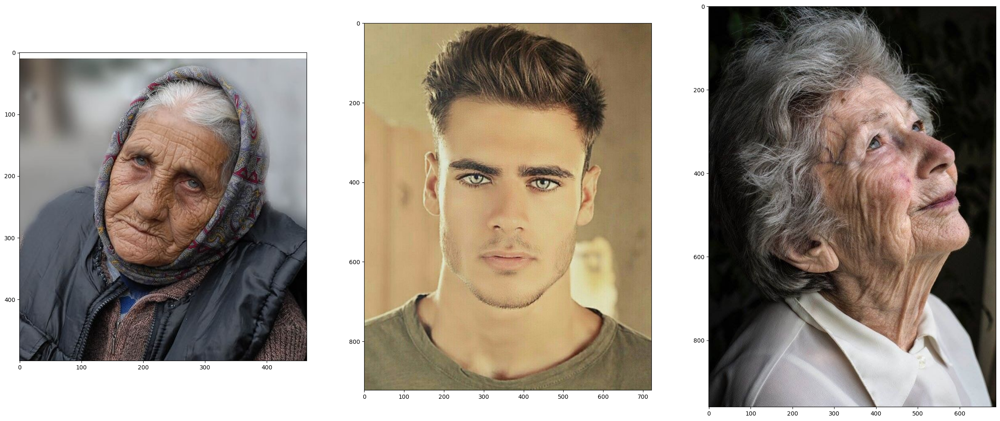

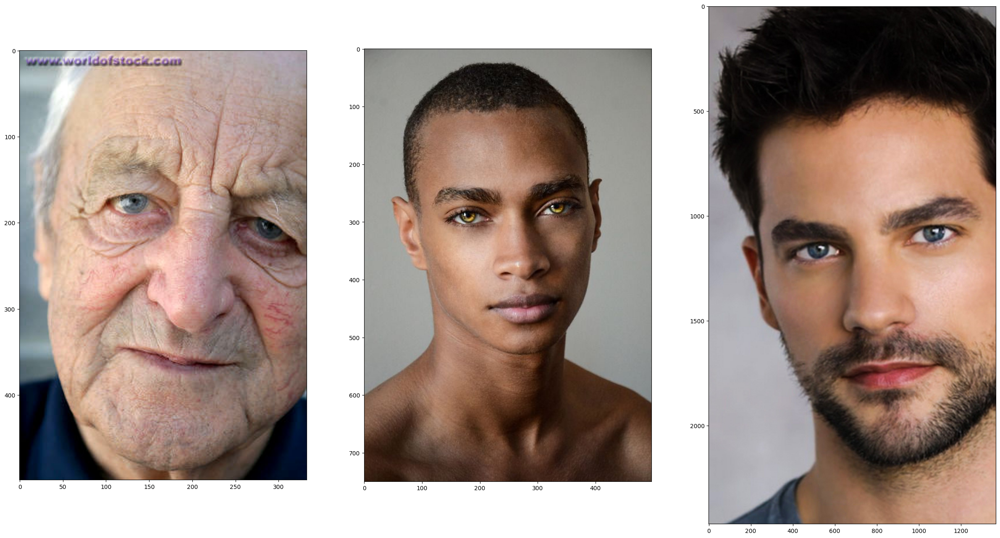

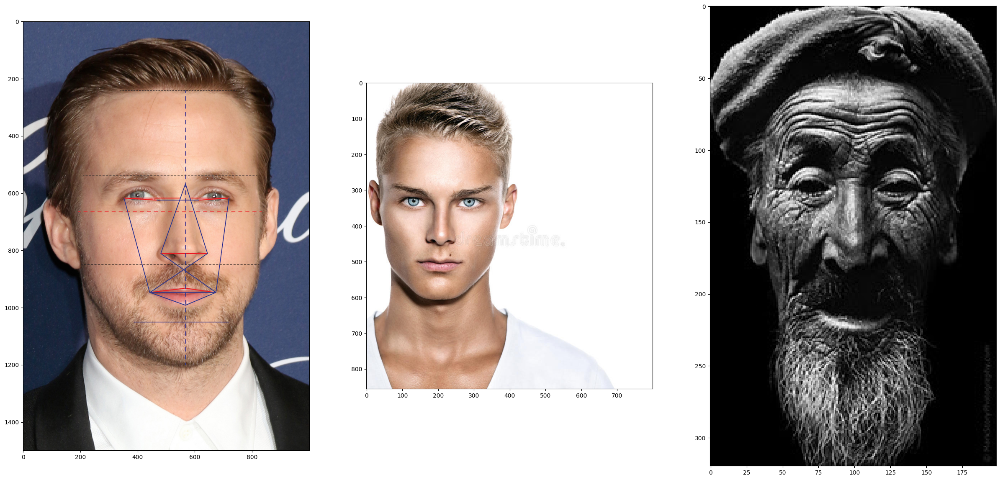

In [ ]:
# Let's print 9 images
image_count = 0
f, axarr = plt.subplots(1,3)
f.set_size_inches(30, 30)

for j in files_name[:9]:
    image = cv2.cvtColor(cv2.imread(os.path.join(path_images, j)), cv2.COLOR_BGR2RGB)

    if image_count >= 3:
        plt.show()
        image_count = 0
        f, axarr = plt.subplots(1,3)
        f.set_size_inches(30, 30)

    axarr[image_count].imshow(image)
    image_count += 1

In [ ]:
print('num images:' + str(len(files_name)))
min_width, min_height, max_width, max_height = 9999, 9999, 0, 0
for i in files_name:
    img = cv2.imread(os.path.join(path_images, i))
    img_height, img_width, _ = img.shape

    min_width = min(min_width, img_width)
    max_width = max(max_width, img_width)
    min_height = min(min_height, img_height)
    max_height = max(max_height, img_height)
    #print(str(img_height), str(img_width))

print('min_width:' + str(min_width))
print('max_width:' + str(max_width))
print('min_heigth:' + str(min_height))
print('max_heigth:' + str(max_height))

num images:7219
min_width:194
max_width:8675
min_heigth:232
max_heigth:7680


## 3. Processing the dataset

Let's segment the face, and iris. We need a mask with that information for each image. We need to create a mask with that information for each image. An example of a mask is given below.

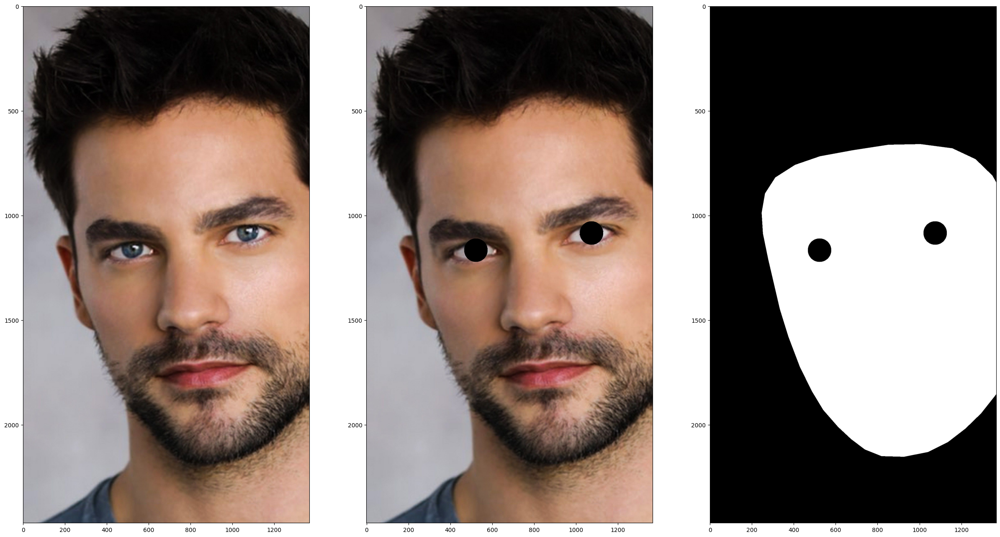

Since the names of this dataset are not in a good format, we will copy the images to a new location with a more friendly name during the creation of all masks. We are only interested in shapes, not in colors, so we can use images in gray scale.

In [ ]:
path_base = '/kaggle/working/base'
try:
    os.mkdir(path_base)
except OSError as error:
    print(error)

Let's show the first 10 images and masks to verify it.

image_0.jpeg mask_0.jpeg
image_1.jpeg mask_1.jpeg
image_2.jpeg mask_2.jpeg
image_3.jpeg mask_3.jpeg
image_4.jpeg mask_4.jpeg
image_5.jpeg mask_5.jpeg
image_6.jpeg mask_6.jpeg
image_7.jpeg mask_7.jpeg
image_8.jpeg mask_8.jpeg
image_9.jpeg mask_9.jpeg


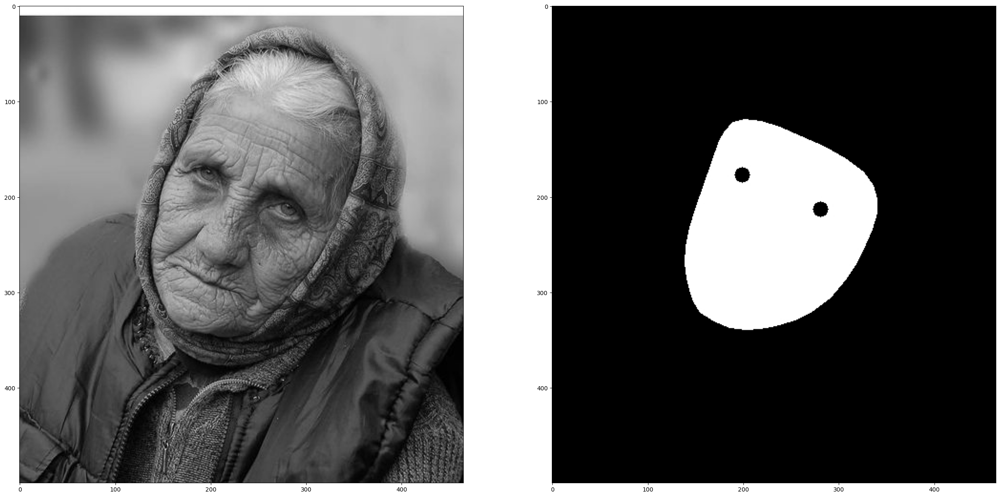

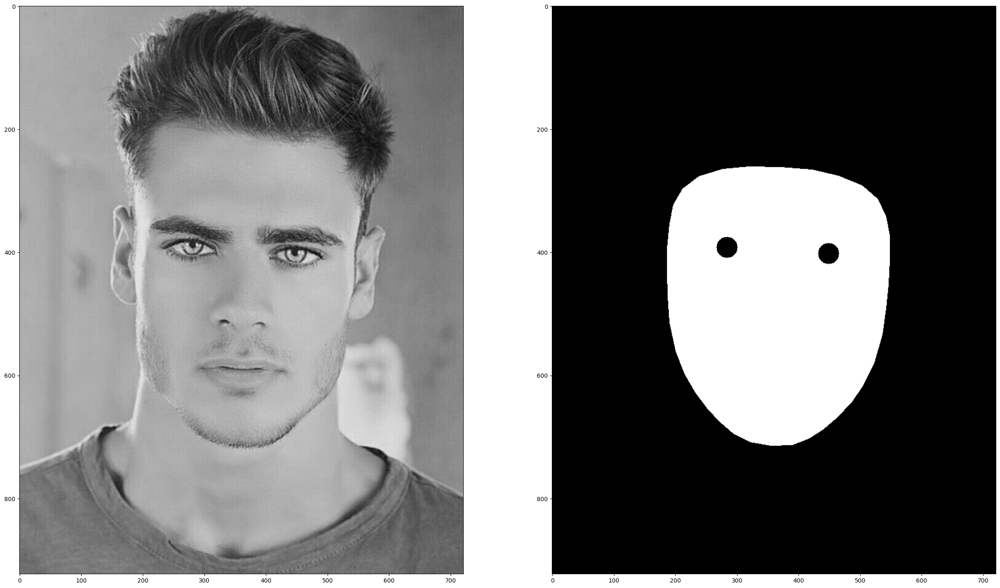

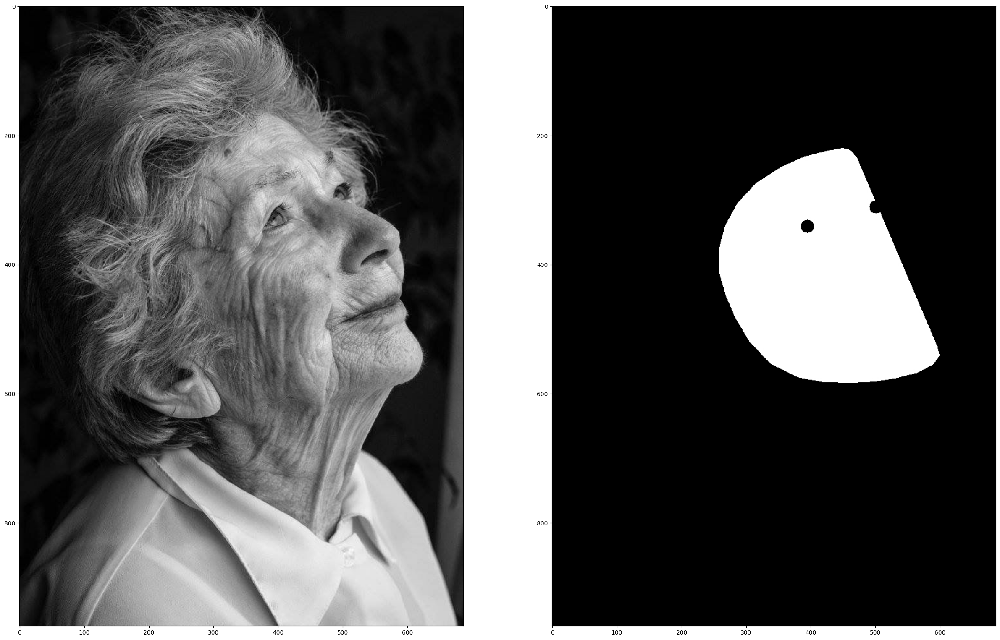

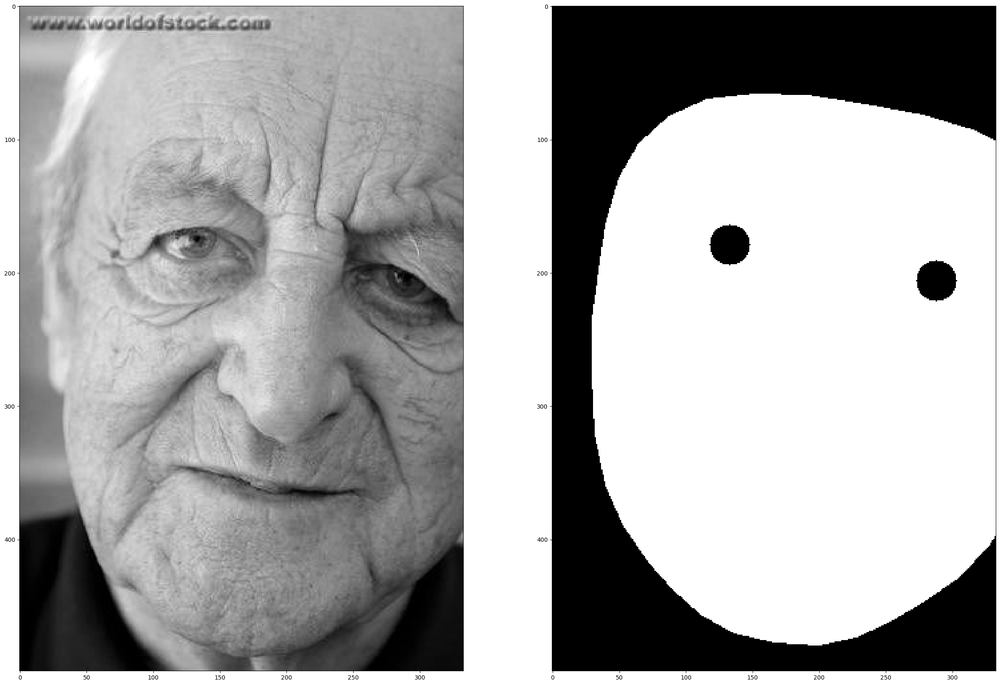

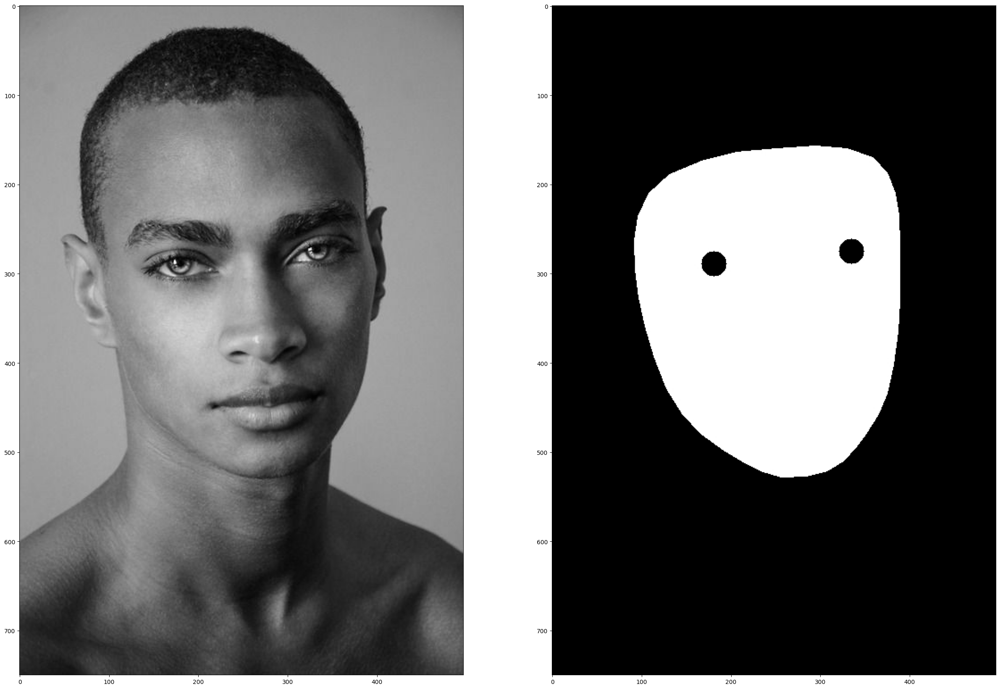

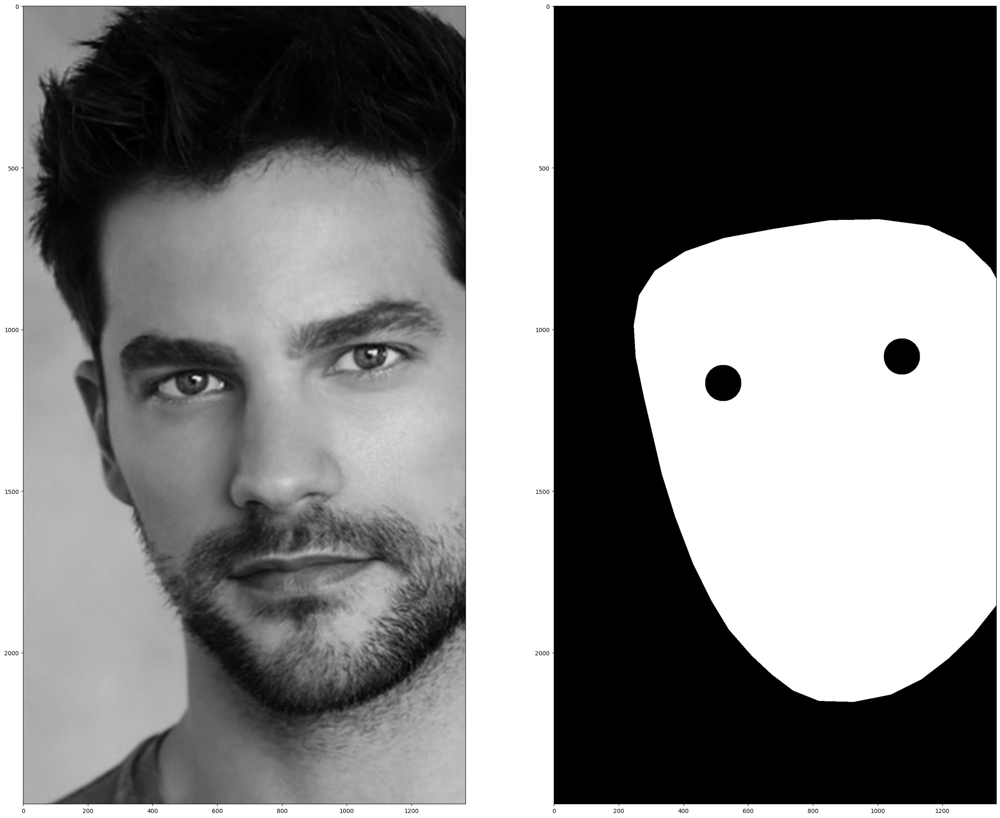

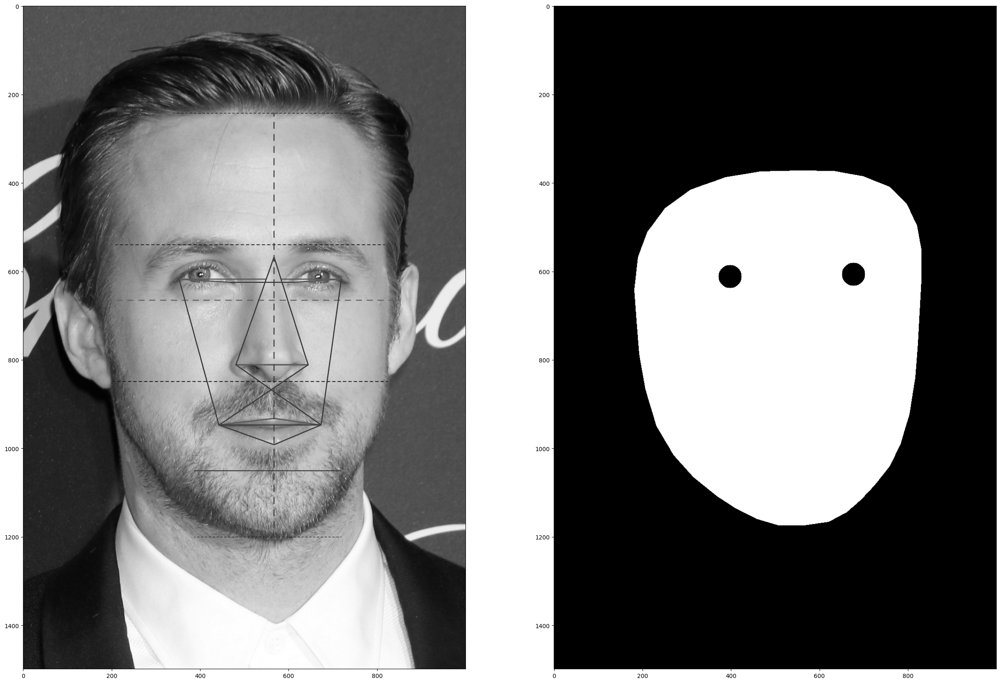

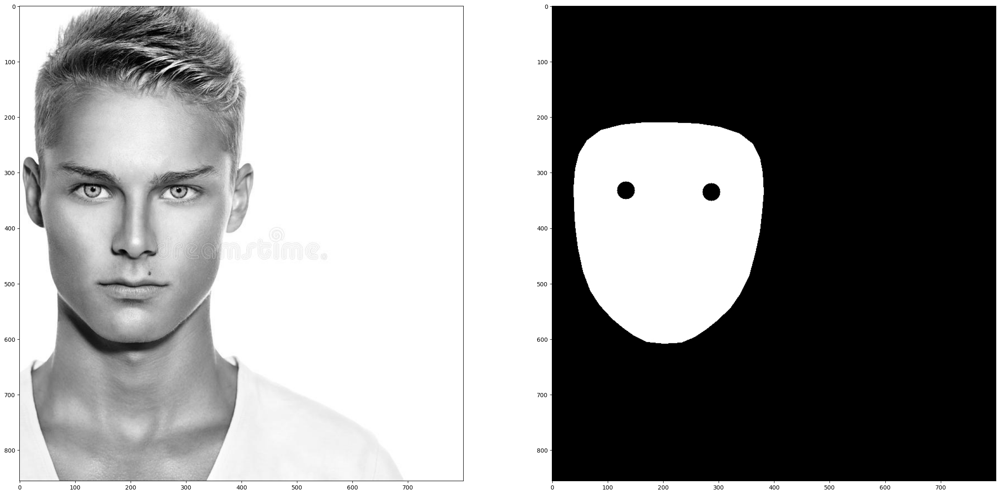

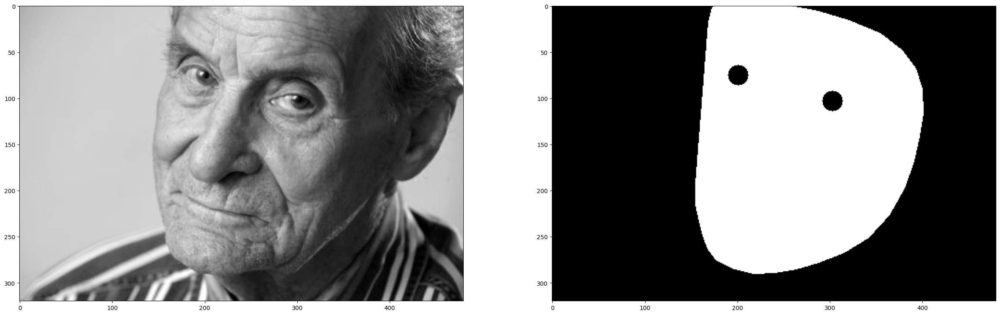

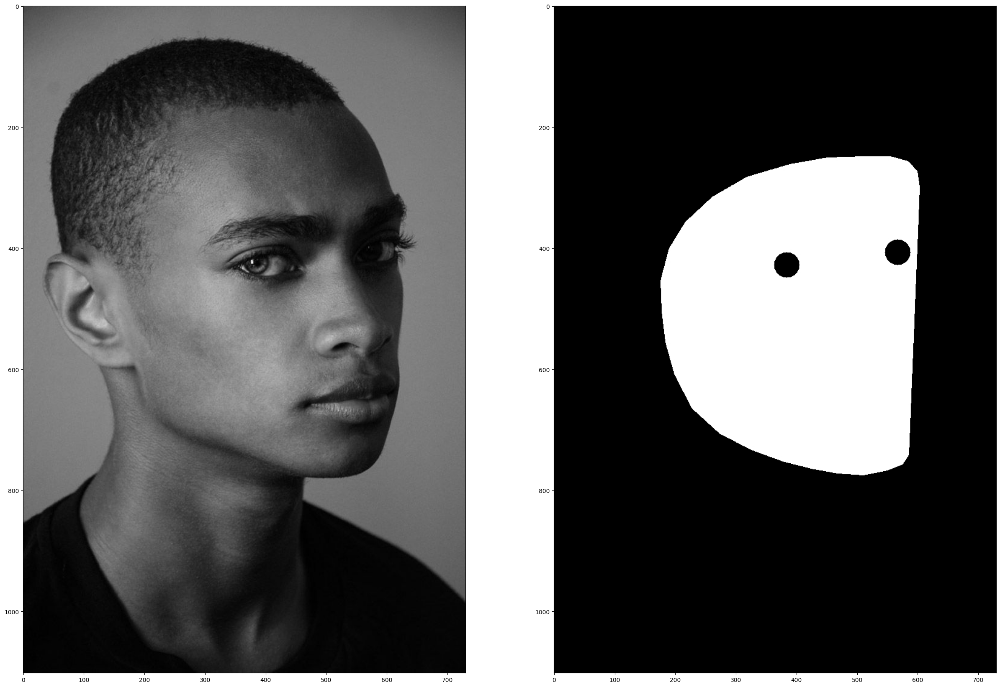

In [ ]:
for j in range(10):
    print(images[j], masks[j])
    image = cv2.imread(os.path.join(path_base, images[j]))
    mask = cv2.imread(os.path.join(path_base, masks[j]))

    f, axarr = plt.subplots(1,2)
    f.set_size_inches(30, 30)

    axarr[0].imshow(image)
    axarr[1].imshow(mask)

In [ ]:
print(len(images))

6703


We also save the images to a new dataset because we have more than 7k images, and most computers do not have enouth memory to load all the images ate same time.

After processing all the images, we need to verify it to assure there is no outliers.

## 4. Model

Next we will shuffle the data set and divide it as 80% for training, 15% for validation and 5% for test.

In [ ]:
def unison_shuffled_copies(a, b):
    a = np.array(a)
    b = np.array(b)
    if len(a) == len(b):
      p = np.random.permutation(len(a))
      return list(np.squeeze(a[p])), list(np.squeeze(b[p]))
    else:
      return [], []

In [ ]:
partiton = [0.80, 0.95, 1]
input_list, output_list = unison_shuffled_copies(images, masks)

x_names_train = input_list[0:int(partiton[0]*len(input_list))]
y_names_train = output_list[0:int(partiton[0]*len(output_list))]

x_names_val = input_list[int(partiton[0]*len(input_list)):int(partiton[1]*len(input_list))]
y_names_val = output_list[int(partiton[0]*len(output_list)):int(partiton[1]*len(output_list))]

x_names_test = input_list[int(partiton[1]*len(input_list)):int(partiton[2]*len(input_list))]
y_names_test = output_list[int(partiton[1]*len(output_list)):int(partiton[2]*len(output_list))]

We can define our mobile_U-net to work with images square image of 128, 256, 512 or 1024. More than that will require a lots of memory and computer processing. Originaly i willing to use 512 images, but since the lowest image of the data set have a width of 194, we will use 256.

In [ ]:
def conv_block(inputs, num_filters):
    x = Conv2D(num_filters, 3, padding='same')(inputs)
    x = BatchNormalization()(x)
    x = Activation('relu')(x)

    x = Conv2D(num_filters, 3, padding='same')(x)
    x = BatchNormalization()(x)
    x = Activation('relu')(x)

    return x

def decoder_block(inputs, skip, num_filters):
    x = Conv2DTranspose(num_filters, (2, 2), strides=2, padding="same")(inputs)
    x = Concatenate()([x, skip])
    x = conv_block(x, num_filters)

    return x


def mobilenet_unet(input_shape=(256, 256, 3)):

    #input and preprocessing
    inputs = tf.keras.Input(shape=input_shape)
    preprocessing = tf.keras.layers.experimental.preprocessing.Rescaling(1./255., offset=0, name="re_1")(inputs)

    #pre treined mobile net
    encoder = MobileNetV2(input_tensor=preprocessing, include_top=False, weights='imagenet', alpha=1.4)

    # Encoder
    s1 = encoder.get_layer("re_1").output                  # (256 x 256)
    s2 = encoder.get_layer("block_1_expand_relu").output   # (128 x 128)
    s3 = encoder.get_layer("block_3_expand_relu").output   # (64 x 64)
    s4 = encoder.get_layer("block_6_expand_relu").output   # (32 x 32)

    # Bridge
    b1 = encoder.get_layer("block_13_expand_relu").output             # (16 x 16)

    # Decoder
    base = int(32)
    d1 = decoder_block(b1, s4, int(base*8))                        # (32 x 32)
    d2 = decoder_block(d1, s3, int(base*4))                        # (64 x 64)
    d3 = decoder_block(d2, s2, int(base*2))                        # (128 x 128)
    d4 = decoder_block(d3, s1, base)                               # (256 x 256)

    # Output
    num_class = 1 # if more then one, use softmax
    outputs = Conv2D(num_class, 1, padding='same', activation = 'sigmoid')(d4)

    model = Model(inputs, outputs, name="MobileNetV2_U-Net")

    return model

In [ ]:
model = mobilenet_unet()
model.summary()

17831080/17831080 [==============================] - 0s 0us/step
Model: "MobileNetV2_U-Net"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_1 (InputLayer)           [(None, 256, 256, 3  0           []                               
                                )]                                                                
                                                                                                  
 re_1 (Rescaling)               (None, 256, 256, 3)  0           ['input_1[0][0]']                
                                                                                                  
 Conv1 (Conv2D)                 (None, 128, 128, 48  1296        ['re_1[0][0]']                   
                                )                                                                 
                 

In [ ]:
#tf.keras.utils.plot_model(model, show_shapes=True)

The following code has the propose to test the model batch generation.

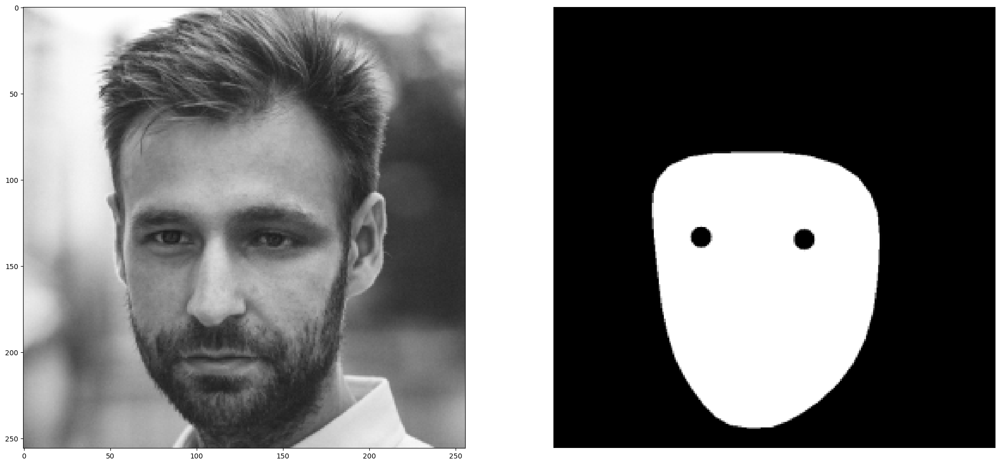

inp_image shape: (256, 256, 3)
out_image shape: (256, 256, 1)
out_image max: 1
out_image min: 0
out_image mean: 0.2545623779296875


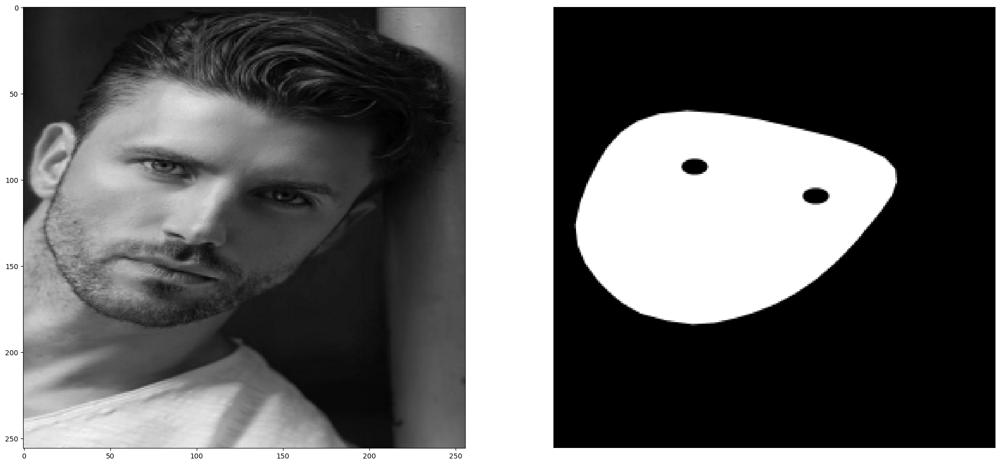

inp_image shape: (256, 256, 3)
out_image shape: (256, 256, 1)
out_image max: 1
out_image min: 0
out_image mean: 0.2480010986328125


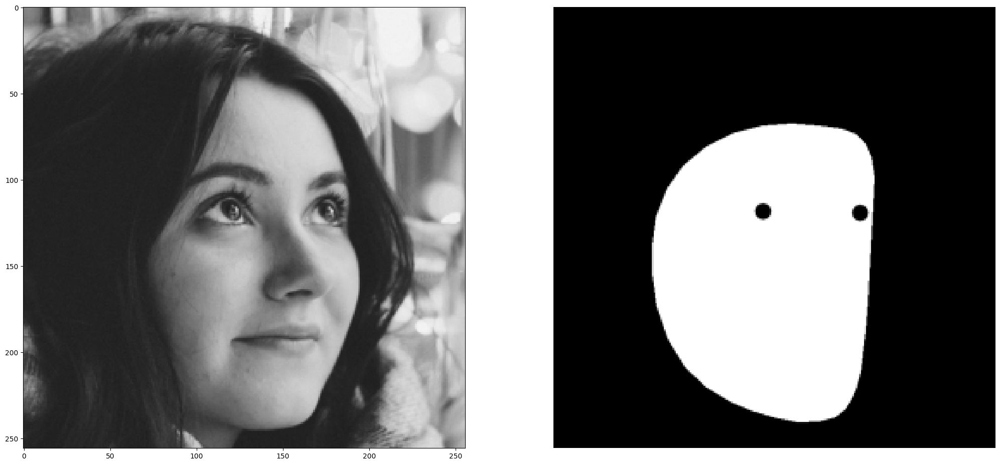

inp_image shape: (256, 256, 3)
out_image shape: (256, 256, 1)
out_image max: 1
out_image min: 0
out_image mean: 0.273468017578125


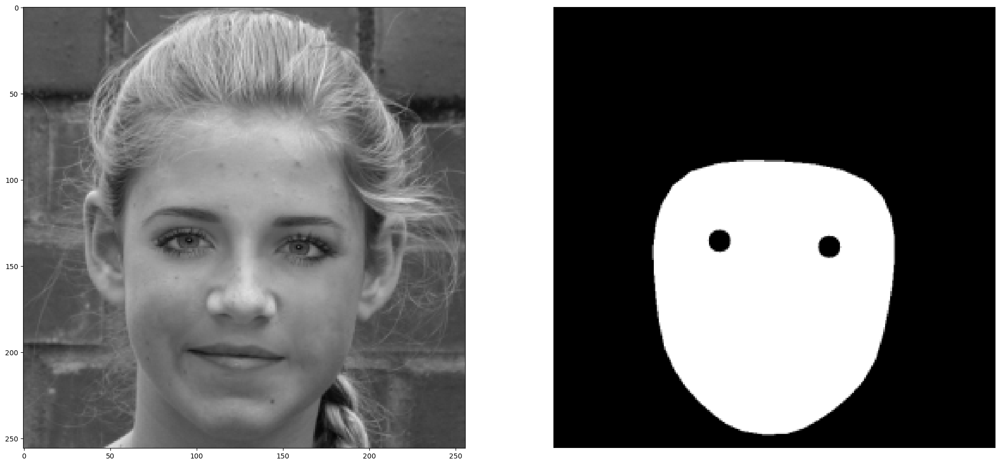

inp_image shape: (256, 256, 3)
out_image shape: (256, 256, 1)
out_image max: 1
out_image min: 0
out_image mean: 0.26971435546875


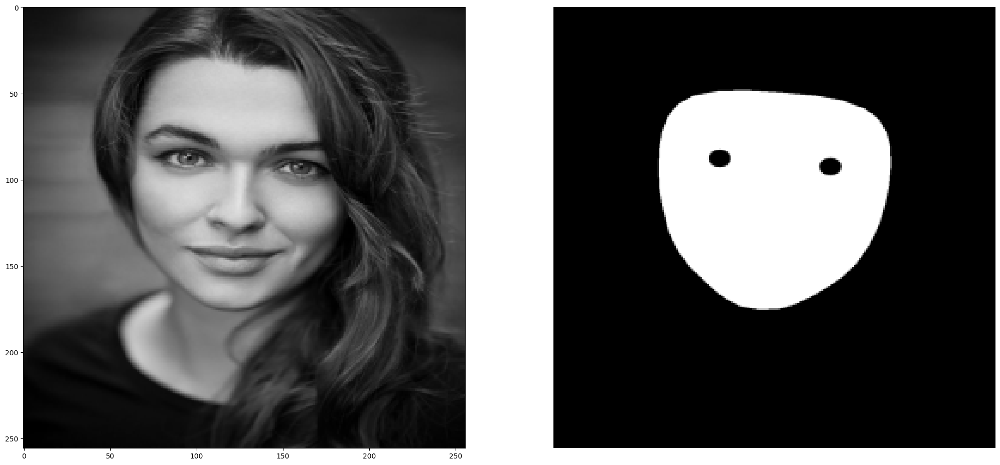

inp_image shape: (256, 256, 3)
out_image shape: (256, 256, 1)
out_image max: 1
out_image min: 0
out_image mean: 0.2032928466796875


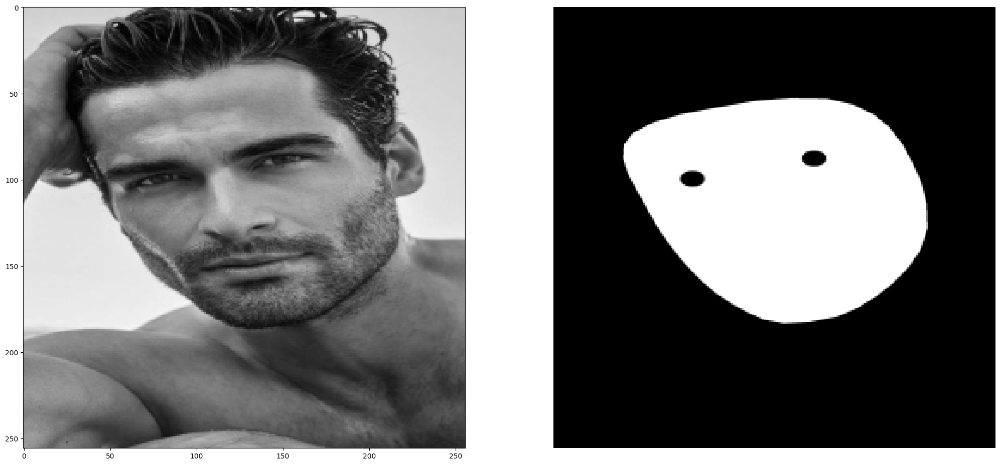

inp_image shape: (256, 256, 3)
out_image shape: (256, 256, 1)
out_image max: 1
out_image min: 0
out_image mean: 0.2539215087890625


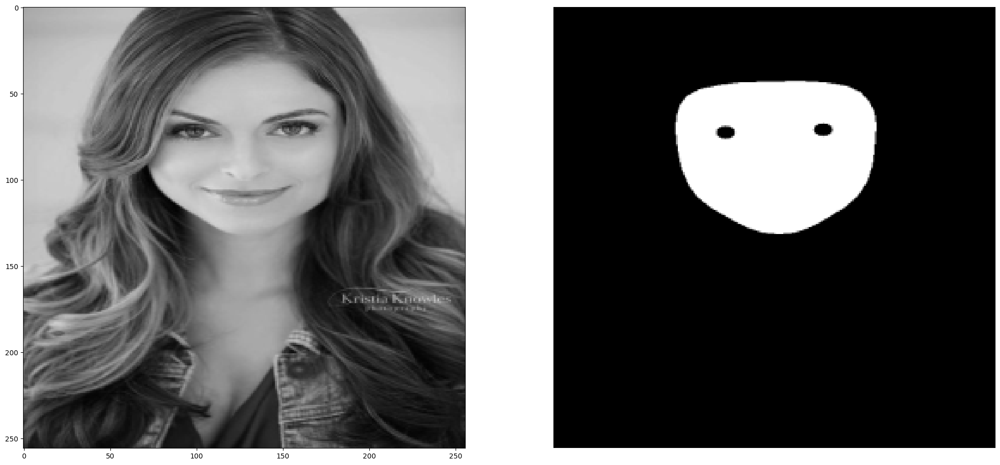

inp_image shape: (256, 256, 3)
out_image shape: (256, 256, 1)
out_image max: 1
out_image min: 0
out_image mean: 0.123504638671875


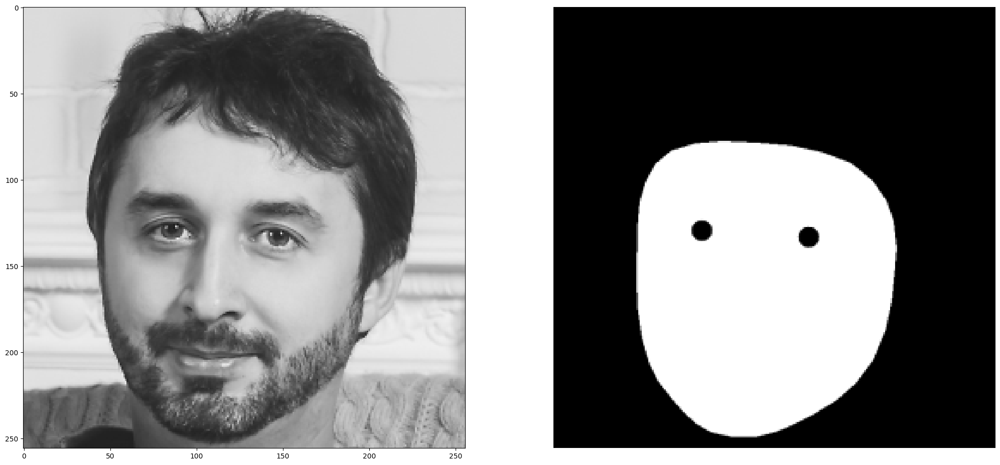

inp_image shape: (256, 256, 3)
out_image shape: (256, 256, 1)
out_image max: 1
out_image min: 0
out_image mean: 0.3161468505859375


batch X shape: (8, 256, 256, 3)
batch y shape: (8, 256, 256, 1)


In [ ]:
#image and output print for verification
size_image_model = (256, 256)
import random

list_samples = random.sample(range(0, 1200), 8)

X = []
y = []

#list = [1, 200, 400, 879, 1000, 1759]
for i in list_samples:
  inp_image = cv2.imread(os.path.join(path_base, str(x_names_train[i])))
  out_image = cv2.imread(os.path.join(path_base,str(y_names_train[i])))
  inp_image = cv2.resize(inp_image, size_image_model, interpolation=cv2.INTER_AREA)
  out_image = cv2.resize(out_image, size_image_model, interpolation=cv2.INTER_AREA)

  #print images
  aux = 0
  f, axarr = plt.subplots(1,2)
  plt.grid(False)
  plt.axis('off')
  f.set_size_inches(25, 25)
  axarr[0].imshow(inp_image)
  axarr[1].imshow(out_image)
  plt.show()

  inp_image_np = np.array(inp_image).astype(np.float32)
  inp_image_np = inp_image_np.reshape(size_image_model+tuple([3]))
  print('inp_image shape: ' + str(inp_image_np.shape))

  out_image_np = np.array(out_image).astype(np.int32)
  out_image_np = np.squeeze(out_image_np)
  out_image_np = out_image_np[:,:]/255
  out_image_np = out_image_np.astype(np.int32)
  out_image_np = out_image_np[:,:,0]
  out_image_np = out_image_np.reshape(size_image_model+tuple([1]))
  print('out_image shape: '+ str(out_image_np.shape))
  print('out_image max: '+ str(np.max(out_image_np)))
  print('out_image min: '+ str(np.min(out_image_np)))
  print('out_image mean: '+ str(np.mean(out_image_np)))

  X.append(inp_image_np)
  y.append(out_image_np)

print('\n')
X = np.asarray(X, np.float32)
print('batch X shape: ' + str(X.shape))
y = np.asarray(y, np.float32)
print('batch y shape: ' + str(y.shape))

Now we can define the batch (or data) generation to train our neural network. There arre a lot of transformations to be made, but in general, we need to reshape our image to 256x256x3, tranform the mask into a matrix 256x256x1 of integers between 0 and 1. It is also recommended to add some augumentation into the image, that usually makes the accuracy higher.

In [ ]:
class DataGenerator(tf.keras.utils.Sequence):
    'Generates data for Keras'
    def __init__(self, list_ID_in, list_ID_out, batch_size=32,
                 dim=size_image_model, shuffle=True, augment=True):
        'Initialization'
        self.dim = dim
        self.batch_size = batch_size
        self.list_ID_out = list_ID_out
        self.list_ID_in = list_ID_in
        self.shuffle = shuffle
        self.on_epoch_end()

        self.augment = augment
        self.transforms = A.Compose([
            A.OneOf([
              #A.ToGray(),
              A.ChannelShuffle(),
            ], p=0.5),
            A.OneOf([
              A.RandomBrightnessContrast(p=0.5),
              A.GaussianBlur(p=0.3),
              A.GaussNoise(var_limit=(1e-5, 1e-3), p=0.5),
            ], p=0.5),
        ])

    def __len__(self):
        'Denotes the number of batches per epoch'
        return int(np.floor(len(self.list_ID_in) / self.batch_size))

    def __getitem__(self, index):
        'Generate one batch of data'
        # Generate indexes of the batch
        indexes = self.indexes[index*self.batch_size:(index+1)*self.batch_size]

        # Find list of IDs
        list_ID_in_temp = [self.list_ID_in[k] for k in indexes]
        list_ID_out_temp = [self.list_ID_out[k] for k in indexes]

        # Generate data
        X, y = self.__data_generation(list_ID_in_temp, list_ID_out_temp)

        return X, y

    def on_epoch_end(self):
        'Updates indexes after each epoch'
        self.indexes = np.arange(len(self.list_ID_in))
        if self.shuffle == True:
            np.random.shuffle(self.indexes)

    def __data_generation(self, list_ID_in_temp, list_ID_out_temp,
                          path_input=path_base, path_output=path_base):
        'Generates data containing batch_size samples' # X : (n_samples, *dim, n_channels)
        # Initialization

        X = []
        y = []
        for id_in, id_out in zip(list_ID_in_temp, list_ID_out_temp):
          try:
            inp_image = cv2.imread(os.path.join(path_base,str(id_in)))
            out_image = cv2.imread(os.path.join(path_base,str(id_out)))
            inp_image = cv2.resize(inp_image, size_image_model, interpolation=cv2.INTER_AREA)
            out_image = cv2.resize(out_image, size_image_model, interpolation=cv2.INTER_AREA)

            inp_image_np = np.array(inp_image).astype(np.float32)
            inp_image_np = inp_image_np.reshape(size_image_model+tuple([3]))

            out_image_np = np.array(out_image).astype(np.int32)
            out_image_np = np.squeeze(out_image_np)
            out_image_np = out_image_np[:,:]/255
            out_image_np = out_image_np.astype(np.int32)
            out_image_np = out_image_np[:,:,0]
            out_image_np = out_image_np.reshape(size_image_model+tuple([1]))

            if self.augment:
              # augment image
              aug_data = self.transforms(image=inp_image_np)
              X.append(aug_data['image'])
              y.append(out_image_np)

            else:
              X.append(inp_image_np)
              y.append(out_image_np)

          #
          except IOError:
            print(str(id))
            return False
          # filename not an image file

        return np.asarray(X, np.float32), np.asarray(y, np.int32)

    #open image without ext in name
    def open_image_file(self, path, name):
      onlyfiles = [f for f in os.listdir(path) if os.path.isfile(os.path.join(path, f))]
      for fullname in onlyfiles:
        if fnmatch.fnmatch(fullname, name + '.*'):
          return Image.open(os.path.join(path, fullname))

In [ ]:
path_model = '/kaggle/working'
model_name = 'mobilenet_unet'
filepath = path_model + '/' + model_name + '.h5 '
print(filepath)

/kaggle/working/mobilenet_unet.h5 


### 4.1 Model training

In [ ]:
print("Num GPUs Available: ", len(tf.config.list_physical_devices('GPU')))

#per_process_gpu_memory_fraction = False
# Parameters
params = {'dim': size_image_model,
          'batch_size': 32,
          'shuffle': True}

# Generators
training_generator = DataGenerator(x_names_train, y_names_train, augment=True, **params)
validation_generator = DataGenerator(x_names_val, y_names_val, augment=False, **params)

checkpoints = tf.keras.callbacks.ModelCheckpoint(
    filepath = os.path.join(path_model + '/', model_name + '.h5'),
    save_best_only=True,
    #save_weights_only=True,
    monitor='val_loss',
    verbose=1)


earlyStopping = tf.keras.callbacks.EarlyStopping(monitor='loss',
                                  patience=30, mode='min', baseline=None)

tensorboard_callback = tf.keras.callbacks.TensorBoard('tensorboard', histogram_freq=1)


callbacks_list = [checkpoints, CSVLogger('log.csv', append=True, separator=';'), tensorboard_callback]


# Fit the model
model.compile(optimizer='adam',
              loss = 'binary_crossentropy',
              metrics=["accuracy"], )

# Train model on dataset
history = model.fit(training_generator,
                    epochs=50,
                    validation_data=validation_generator,
                    callbacks=callbacks_list,
                    verbose = 1,
                    )

Num GPUs Available:  1
Epoch 1/50
167/167 [==============================] - ETA: 0s - loss: 0.2224 - accuracy: 0.9138
Epoch 1: val_loss improved from inf to 0.34455, saving model to /kaggle/working/mobilenet_unet.h5
167/167 [==============================] - 390s 2s/step - loss: 0.2224 - accuracy: 0.9138 - val_loss: 0.3445 - val_accuracy: 0.9022
Epoch 2/50
167/167 [==============================] - ETA: 0s - loss: 0.1531 - accuracy: 0.9348
Epoch 2: val_loss did not improve from 0.34455
167/167 [==============================] - 340s 2s/step - loss: 0.1531 - accuracy: 0.9348 - val_loss: 0.4960 - val_accuracy: 0.8996
Epoch 3/50
167/167 [==============================] - ETA: 0s - loss: 0.1455 - accuracy: 0.9362
Epoch 3: val_loss improved from 0.34455 to 0.19407, saving model to /kaggle/working/mobilenet_unet.h5
167/167 [==============================] - 339s 2s/step - loss: 0.1455 - accuracy: 0.9362 - val_loss: 0.1941 - val_accuracy: 0.9449
Epoch 4/50
167/167 [==========================

We have trained our Unet for 50 epochs (since this is only a show case), but it is recommended more epochs in a real application.

### 5. Results and posprocessing

In [ ]:
mobilenetv2_Unet = tf.keras.models.load_model('/content/mobilenet_unet.h5')

def call_mobilenetv2_Unet(image):
    tol = 0.5
    image_copy = deepcopy(image)

    image_copy = cv2.resize(image_copy, size_image_model, interpolation=cv2.INTER_AREA)
    gray = cv2.cvtColor(np.uint8(image_copy), cv2.COLOR_BGR2GRAY)

    image_copy[:,:,1] = gray
    image_copy[:,:,2] = gray
    image_np = np.array(image_copy).astype(np.float32)
    image_np = image_np.reshape(size_image_model+tuple([3]))
    image_np = np.expand_dims(image_np, 0)

    mask_out = mobilenetv2_Unet.predict(image_np)
    mask_out = np.asarray(mask_out, np.float32)
    mask_out = np.squeeze(np.asarray(mask_out))

    mask = np.zeros(size_image_model)
    mask[np.where(mask_out > tol)] = 255


    return image_copy, mask

In [ ]:
print('total of test images: ' +str(len(x_names_test)))

total of test images: 336


In [ ]:
images = []
truth = []
for i in range(len(x_names_test)):

  image_np = cv2.imread(os.path.join(path_base, x_names_test[i]))
  image_np = cv2.resize(image_np, size_image_model, interpolation=cv2.INTER_AREA)

  image_np = np.array(image_np).astype(np.float32)
  out_image_np = np.array(out_image).astype(np.int32)
  out_image_np = np.squeeze(out_image_np)
  out_image_np = out_image_np[:,:]/255
  out_image_np = out_image_np.astype(np.int32)
  out_image_np = out_image_np[:,:,0]
  #out_image_np = out_image_np.reshape(size_image_model+tuple([1]))
  images.append(image_np)
  truth.append(out_image_np)


results = mobilenetv2_Unet.evaluate(np.array(images), np.array(truth), return_dict=True)
for name, value in results.items():
  print(f"{name}: {value:.4f}")

11/11 [==============================] - 2s 103ms/step - loss: 2.2071 - accuracy: 0.7906
loss: 2.2071
accuracy: 0.7906


This loss is very low, since it can be interpreted as a total of 22 pixels in 336 images.

1/1 [==============================] - 0s 28ms/step


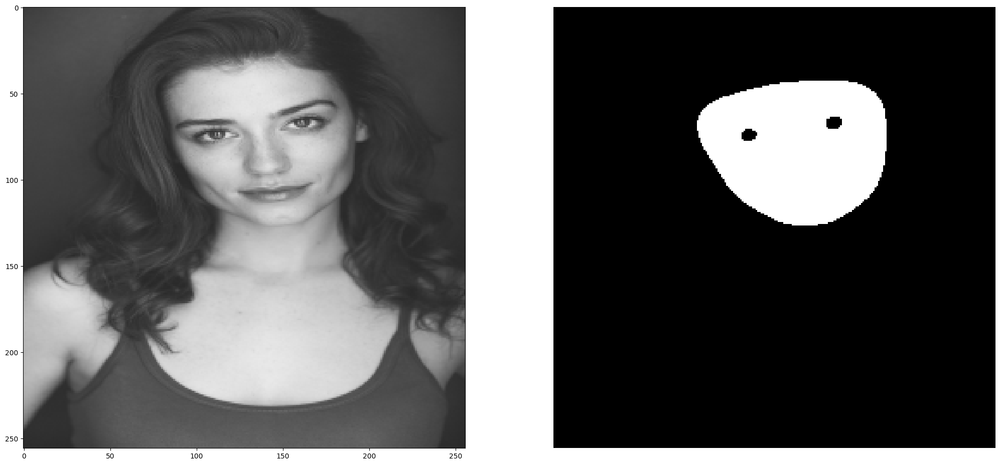

1/1 [==============================] - 0s 26ms/step


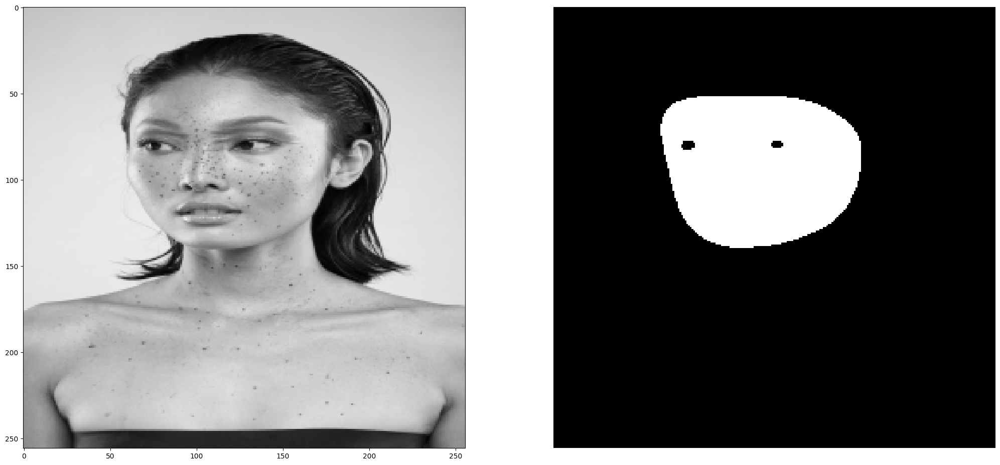

1/1 [==============================] - 0s 28ms/step


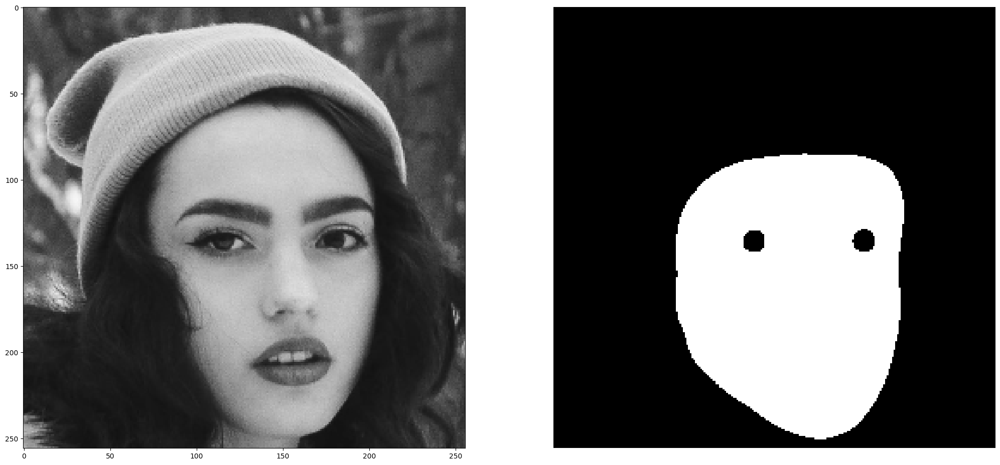

1/1 [==============================] - 0s 26ms/step


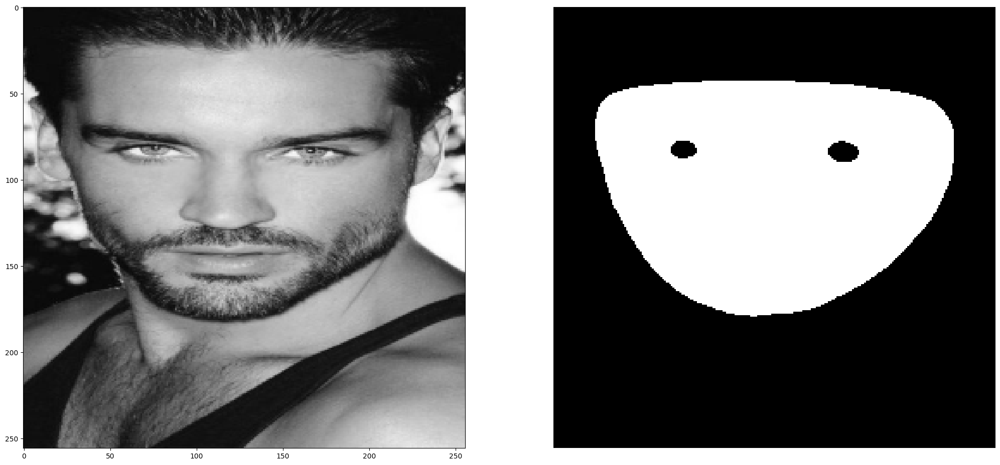

1/1 [==============================] - 0s 30ms/step


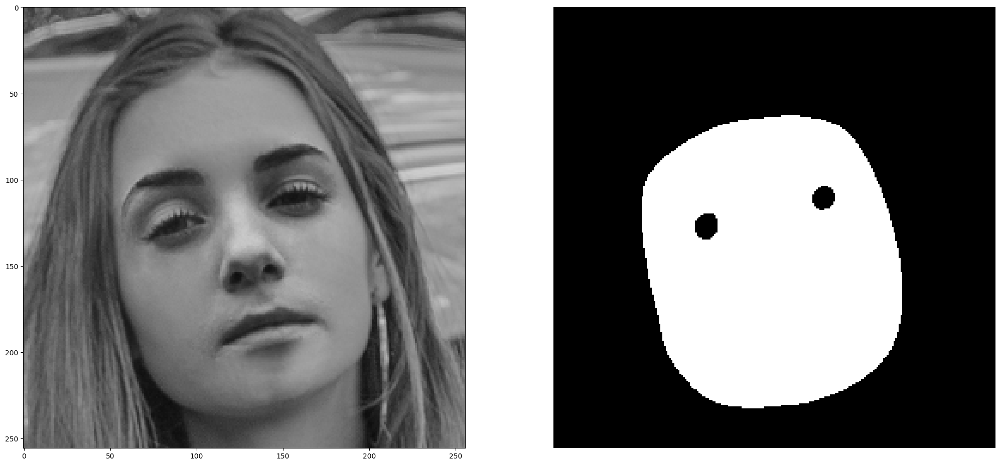

1/1 [==============================] - 0s 26ms/step


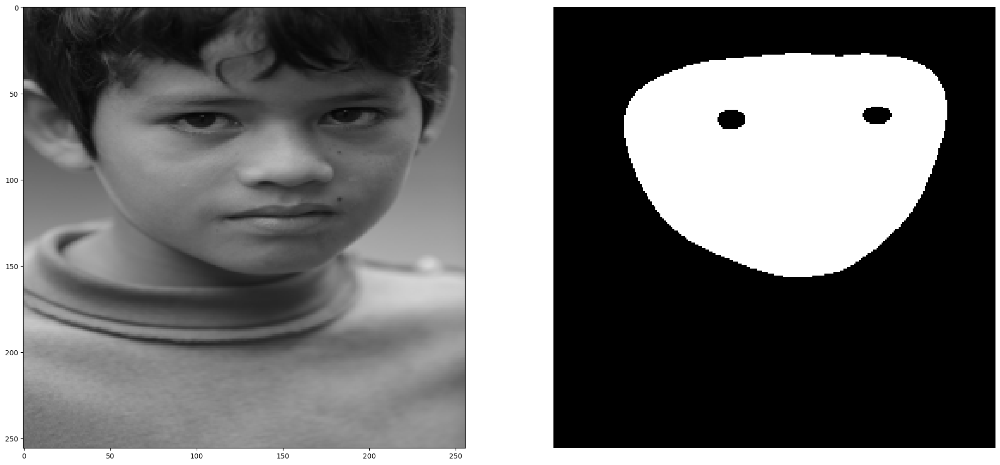

1/1 [==============================] - 0s 28ms/step


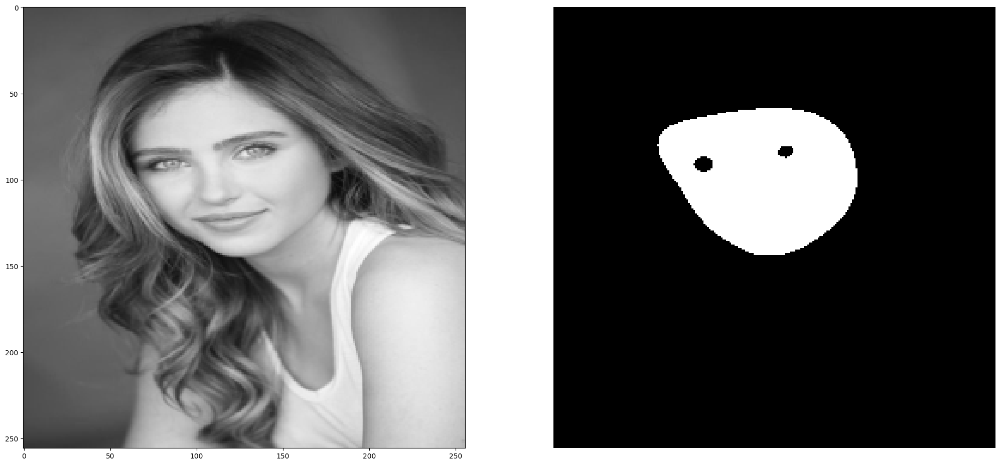

1/1 [==============================] - 0s 28ms/step


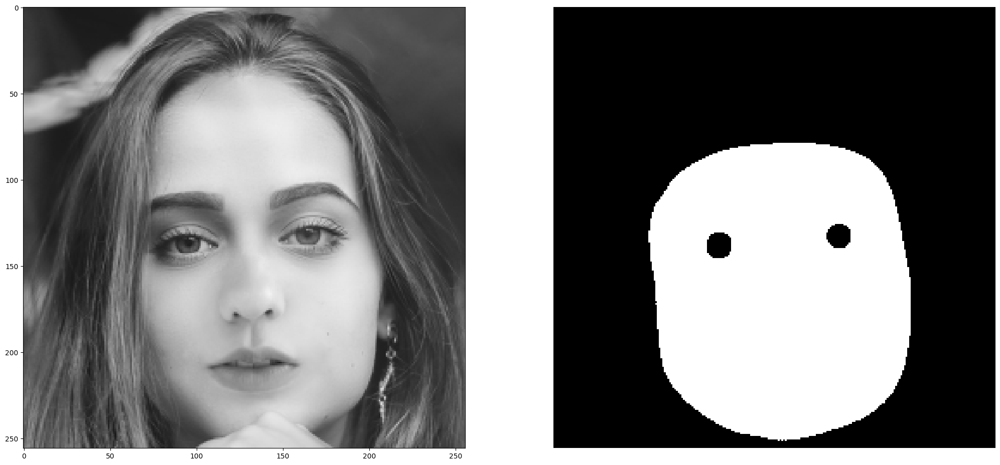

1/1 [==============================] - 0s 28ms/step


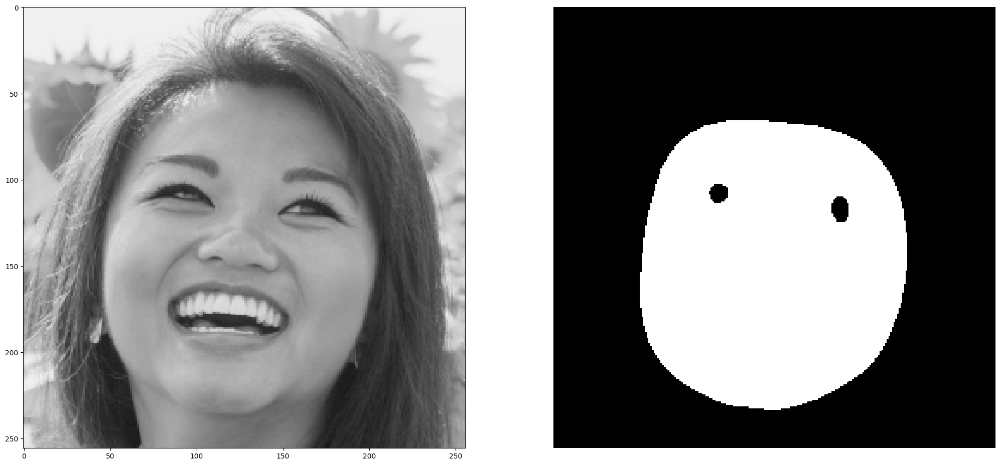

1/1 [==============================] - 0s 27ms/step


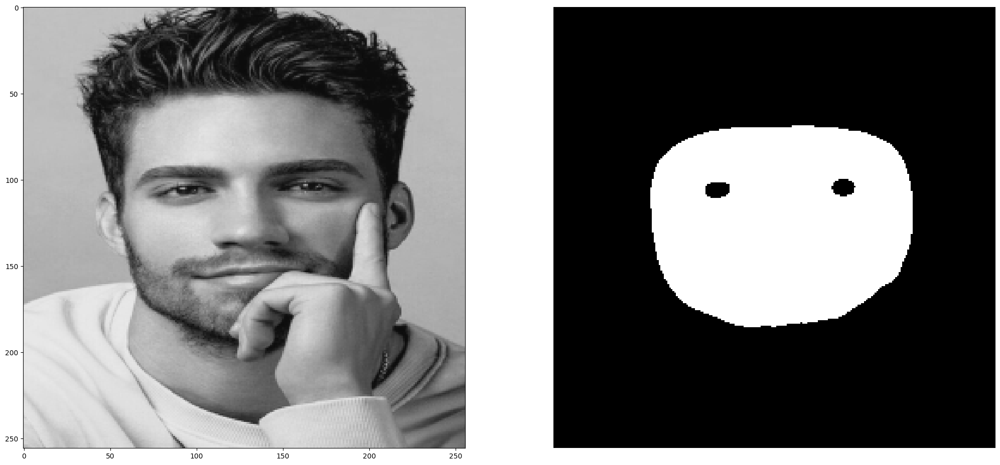

In [ ]:
for i in x_names_test[40:50]:
  inp_image = cv2.imread(os.path.join(path_base, i))

  image, mask = call_mobilenetv2_Unet(inp_image)

  aux = 0
  f, axarr = plt.subplots(1,2)
  plt.grid(False)
  plt.axis('off')
  f.set_size_inches(25, 25)
  axarr[0].imshow(image)
  axarr[1].imshow(mask)
  plt.show()

## 6. Aplications

As an application we can isolete the facial region and cut it or get the contours of the face and eyes, this can be used to obtain the facial shape or isolete the eyes. Lets use a small set of images to define and thest the applications.

In [ ]:
x_names_test = ['/content/1 (210).jpg', '/content/1 (6867).jpg', '/content/1 (6921).jpg', '/content/1 (6928).jpg']
path_base = ''
size_image_model = (256,256)

1/1 [==============================] - 1s 1s/step


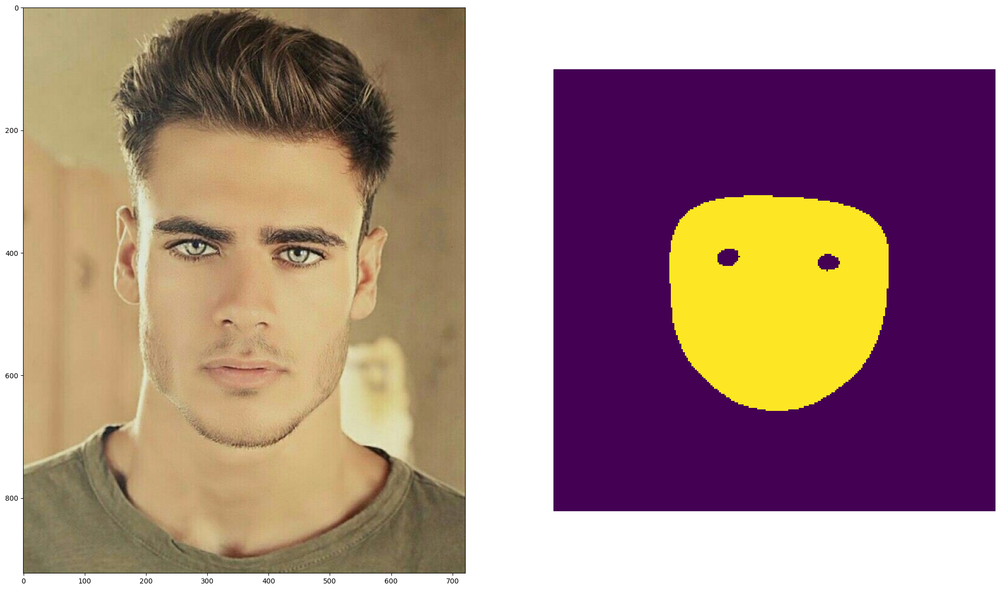

1/1 [==============================] - 1s 847ms/step


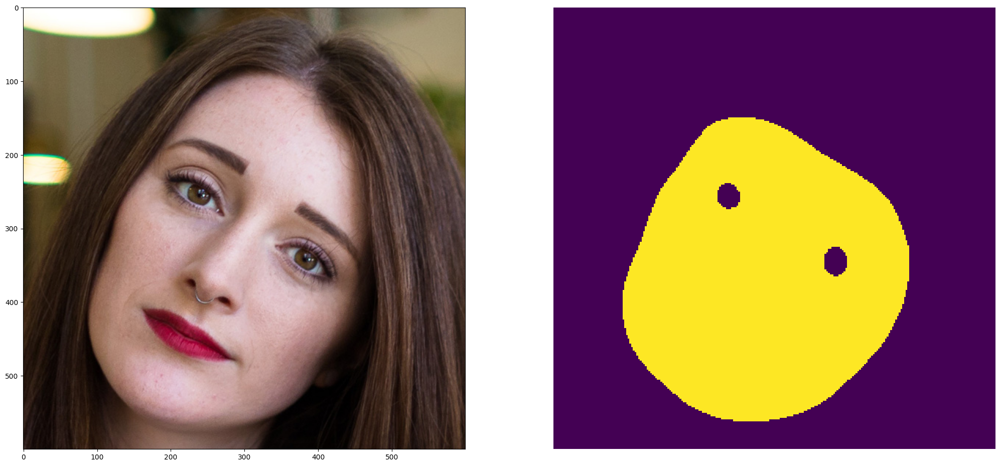

1/1 [==============================] - 1s 900ms/step


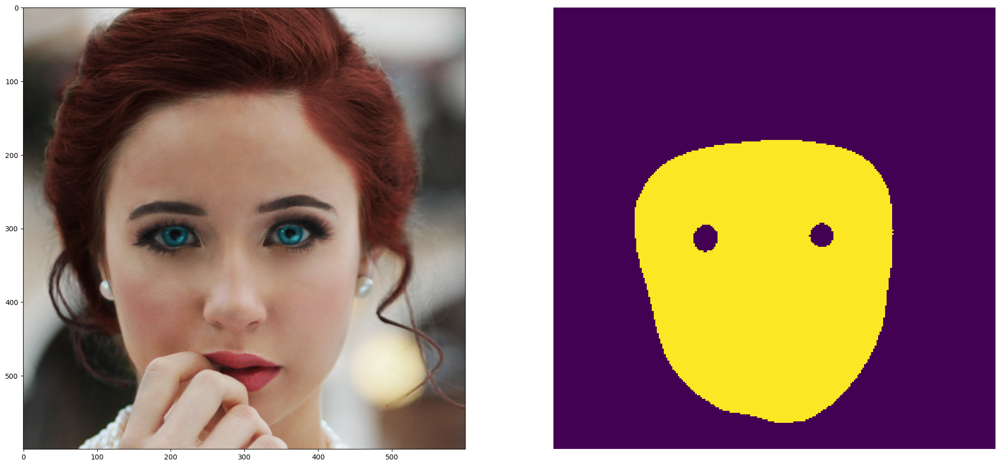

1/1 [==============================] - 1s 545ms/step


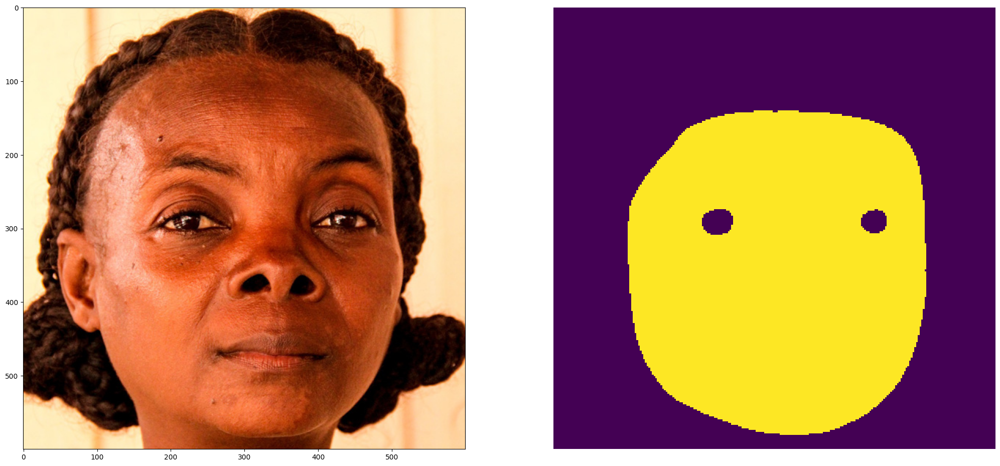

In [ ]:
for i in x_names_test:
  inp_image = cv2.imread(os.path.join(path_base, i))

  image, mask = call_mobilenetv2_Unet(inp_image)

  aux = 0
  f, axarr = plt.subplots(1,2)
  plt.grid(False)
  plt.axis('off')
  f.set_size_inches(25, 25)
  axarr[0].imshow(cv2.cvtColor(inp_image, cv2.COLOR_BGR2RGB))
  axarr[1].imshow(mask)
  plt.show()

In [ ]:
def face_bbox(inp_image):
  image, mask = call_mobilenetv2_Unet(inp_image)

  mask_indexes = np.where(mask[:,:] > 200)

  face_xmin = np.min(mask_indexes[1])
  face_xmax = np.max(mask_indexes[1])
  face_ymin = np.min(mask_indexes[0])
  face_ymax = np.max(mask_indexes[0])

  return image, face_xmin/256, face_ymin/256, face_xmax/256, face_ymax/256

In [ ]:
def eye_bbox(inp_image):
  image, mask = call_mobilenetv2_Unet(inp_image)
  image_height, image_width, _ = image.shape

  gray = np.uint8(np.squeeze(mask[:,:]))

# Apply thresholding or other preprocessing techniques if necessary
  canny = cv2.Canny(gray, 30, 200)

# Find contours in the image
  contours, _ = cv2.findContours(canny,
                                 cv2.RETR_TREE,
                                 cv2.CHAIN_APPROX_SIMPLE)

  sorted_contours = sorted(contours, key=lambda x: cv2.contourArea(x), reverse=True)

  image_contours = deepcopy(image)

  # first eye
  e1_xmin, e2_xmin = 1, 1
  e1_xmax, e2_xmax = 0, 0
  e1_ymin, e2_ymin = 1, 1
  e1_ymax, e2_ymax = 0, 0

  for contour in sorted_contours[2:3]:

    for point in contour:
      #print(point[0][1])
      x = point[0][0]/256
      y = point[0][1]/256

      if x < e1_xmin:
        e1_xmin = x
      if x > e1_xmax:
        e1_xmax = x
      if y < e1_ymin:
        e1_ymin = y
      if y > e1_ymax:
        e1_ymax = y
      #new_contour.append(point)

  for contour in sorted_contours[4:5]:
    new_contour = []
    image_contours = deepcopy(image)
    for point in contour:
      x = point[0][0]/256
      y = point[0][1]/256

      if x < e2_xmin:
        e2_xmin = x
      if x > e2_xmax:
        e2_xmax = x
      if y < e2_ymin:
        e2_ymin = y
      if y > e2_ymax:
        e2_ymax = y

  return image, 0.88*e1_xmin, 1.12*e1_xmax, 0.97*e1_ymin, 1.03*e1_ymax,\
              0.92*e2_xmin, 1.08*e2_xmax, 0.97*e2_ymin, 1.03*e2_ymax

1/1 [==============================] - 1s 1s/step


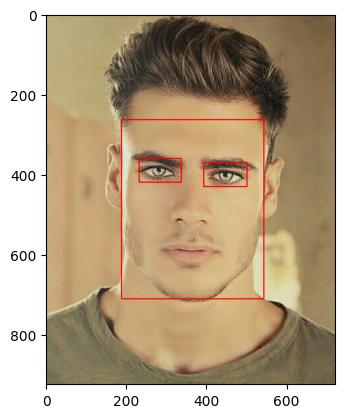

1/1 [==============================] - 1s 711ms/step


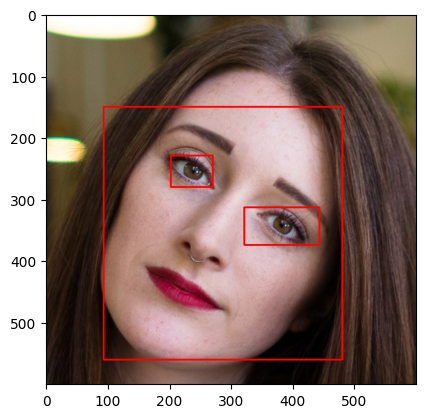

1/1 [==============================] - 0s 474ms/step


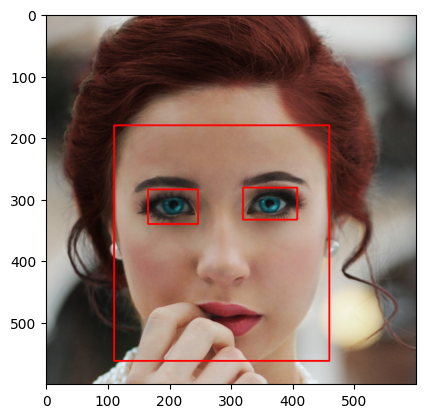

1/1 [==============================] - 0s 468ms/step


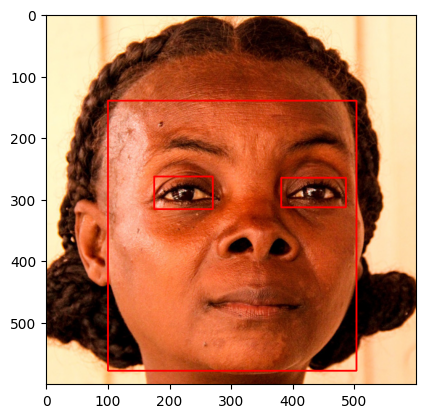

In [ ]:
for i in x_names_test:
  inp_image = cv2.imread(os.path.join(path_base, i))
  image_height, image_width, _ = inp_image.shape

  image, x, y, x_max, y_max = face_bbox(inp_image)

  image, e1_xmin, e1_xmax, e1_ymin, e1_ymax, e2_xmin, e2_xmax, e2_ymin, e2_ymax = eye_bbox(inp_image)

  image_bbox = cv2.rectangle(inp_image, pt1 = (int(x*image_width), int(y*image_height)),
                                   pt2 = (int(x_max*image_width), int(y_max*image_height)),
                                   color = (0,0,255), thickness = 2)
  image_bbox = cv2.rectangle(image_bbox, pt1 = (int(e1_xmin*image_width), int(e1_ymin*image_height)),
                                   pt2 = (int(e1_xmax*image_width), int(e1_ymax*image_height)),
                                   color = (0,0,255), thickness = 2)
  image_bbox = cv2.rectangle(image_bbox, pt1 = (int(e2_xmin*image_width), int(e2_ymin*image_height)),
                                   pt2 = (int(e2_xmax*image_width), int(e2_ymax*image_height)),
                                   color = (0,0,255), thickness = 2)

  plt.imshow(cv2.cvtColor(image_bbox, cv2.COLOR_BGR2RGB))
  plt.show()

1/1 [==============================] - 1s 1s/step


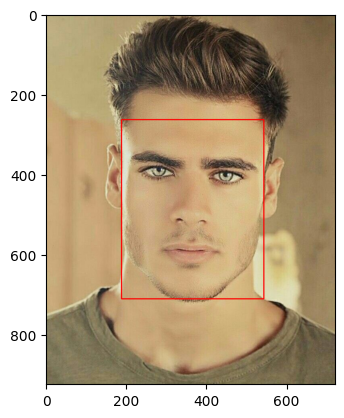

1/1 [==============================] - 1s 681ms/step


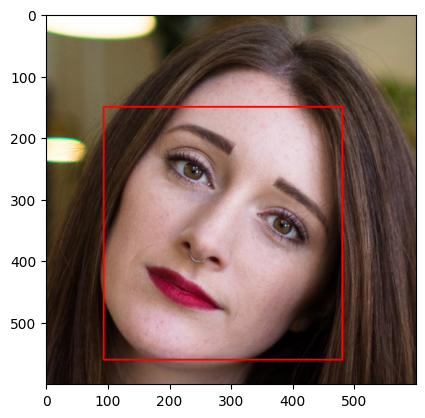

1/1 [==============================] - 1s 718ms/step


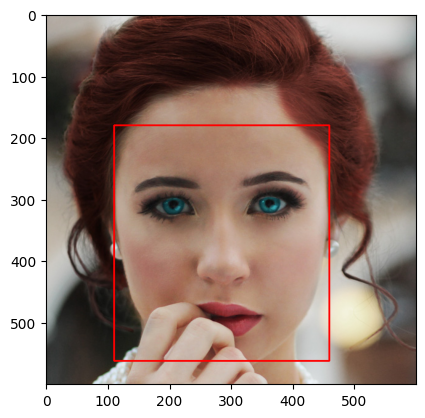

1/1 [==============================] - 1s 680ms/step


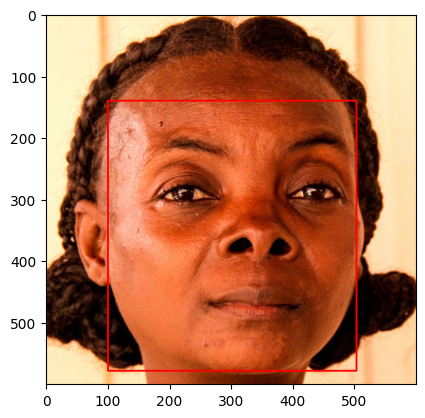

In [ ]:
for i in x_names_test:
  inp_image = cv2.imread(os.path.join(path_base, i))
  image_height, image_width, _ = inp_image.shape

  image, x, y, x_max, y_max = face_bbox(inp_image)


  image_bbox = cv2.rectangle(inp_image, pt1 = (int(x*image_width), int(y*image_height)),
                                   pt2 = (int(x_max*image_width), int(y_max*image_height)),
                                   color = (0,0,255), thickness = 2)


  plt.imshow(cv2.cvtColor(image_bbox, cv2.COLOR_BGR2RGB))
  plt.show()

We can also retrive the contours of the face and iris

In [ ]:
def facial_and_eyes_contour(inp_image):
  image, mask = call_mobilenetv2_Unet(inp_image)
  image_height, image_width, _ = image.shape

  gray = np.uint8(np.squeeze(mask[:,:]))

# Apply thresholding or other preprocessing techniques if necessary
  canny = cv2.Canny(gray, 30, 200)

# Find contours in the image
  contours, _ = cv2.findContours(canny,
                                 cv2.RETR_LIST,
                                 cv2.CHAIN_APPROX_SIMPLE)

  sorted_contours = sorted(contours, key=lambda x: cv2.contourArea(x), reverse=False)

  image_contours = deepcopy(image)
  # to isolete the eyes from the face, we can remove the biggest contour
  for contour in sorted_contours:
    for point in contour:
      #print(point[0][1])
      point[0][0] = int(point[0][0]*image_width/256)
      point[0][1] = int(point[0][1]*image_height/256)

    cv2.drawContours(image_contours, [contour], -1, (0, 255, 0), 1)

  for contour in sorted_contours:
    cv2.drawContours(image_contours, [contour], -1, (0, 255, 0), 1)


  plt.imshow(cv2.cvtColor(image_contours, cv2.COLOR_BGR2RGB))
  plt.show()


1/1 [==============================] - 1s 713ms/step


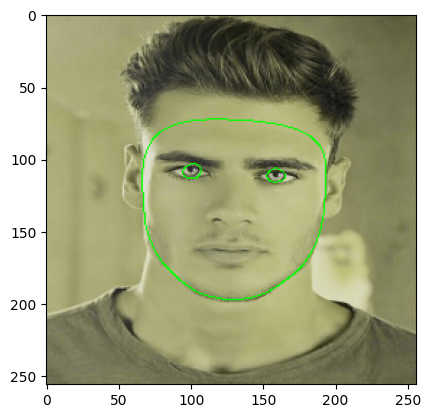

1/1 [==============================] - 1s 726ms/step


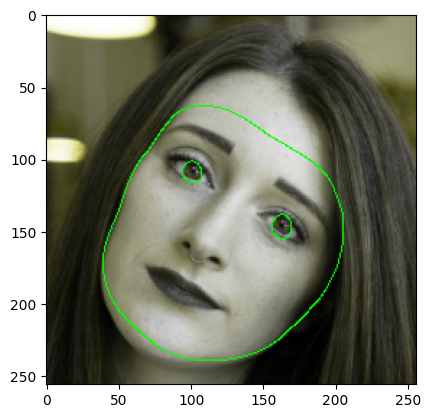

1/1 [==============================] - 1s 1s/step


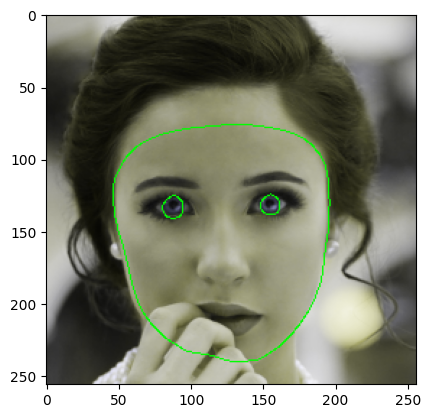

1/1 [==============================] - 0s 420ms/step


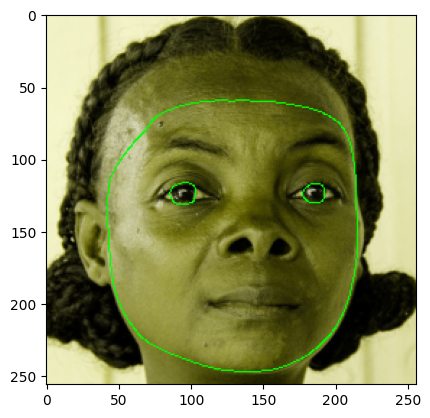

In [ ]:
for i in x_names_test:
  inp_image = cv2.imread(os.path.join(path_base, i))

  facial_and_eyes_contour(inp_image)
